In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
sc.set_figure_params(dpi=100, frameon=False, color_map='Reds')
sc.logging.print_header()

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
2022-06-22 19:44:16.601975: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-06-22 19:44:16.602056: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


scanpy==1.8.2 anndata==0.7.6 umap==0.5.2 numpy==1.20.3 scipy==1.5.3 pandas==1.3.4 scikit-learn==1.0.2 statsmodels==0.11.1 python-igraph==0.8.3 leidenalg==0.8.3 pynndescent==0.5.5


In [3]:
# replicate Meshal's pretty plotting colors
from matplotlib import colors
gray_red = colors.LinearSegmentedColormap.from_list("grouping", ["lightgray", "red", "darkred"], N = 128)

In [4]:
adata = sc.read_h5ad('/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/211011_annot_patient_integrated.h5ad')

In [5]:
adata

AnnData object with n_obs × n_vars = 300353 × 18115
    obs: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'infection_label', '_scvi_batch', '_scvi_labels'
    var: 'used_for_scvi'
    uns: '_scvi', 'cell_type_colors', 'hvg', 'infected_colors', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'treatment_colors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

Taking the scvi-integrated object:

In [225]:
%%time
sc.tl.leiden(adata, resolution=2)

CPU times: user 5min 32s, sys: 12.1 s, total: 5min 44s
Wall time: 5min 57s


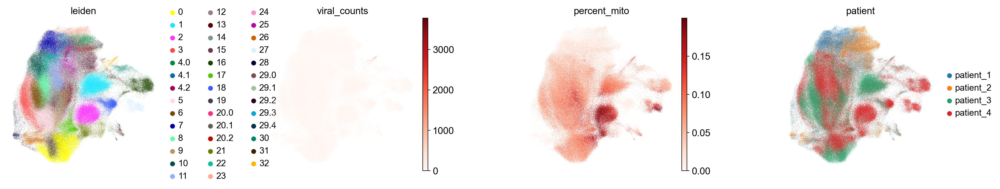

In [273]:
sc.pl.umap(adata, color=['leiden', 'viral_counts', 'percent_mito', 'patient'], wspace=.5)

Make certain leiden cluters a little finer:

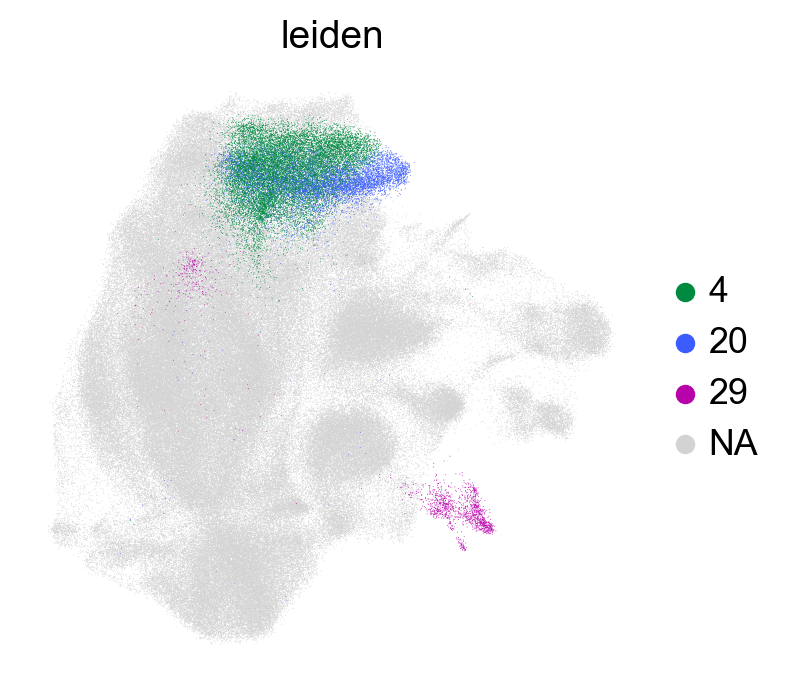

Trying to set attribute `.obs` of view, copying.
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'leiden' as categorical


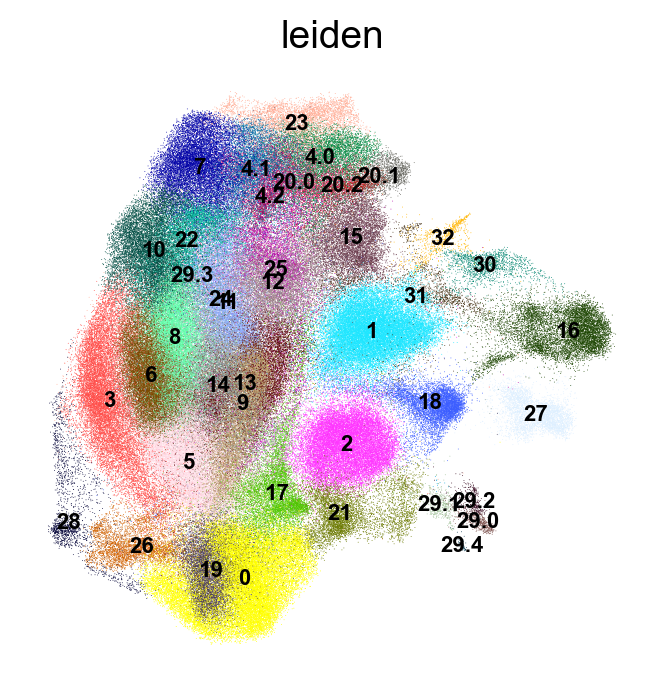

In [227]:
make_finer = ['4', '20', '29']
sc.pl.umap(adata, color='leiden', groups=make_finer)
adata.obs['leiden'] = adata.obs['leiden'].astype(str)  # plotting converts to category

for l in make_finer:
    subset = adata[adata.obs['leiden'] == l]
    sc.tl.leiden(subset, resolution=.3)
    adata.obs['leiden'][adata.obs['leiden'] == l] = l + '.' + subset.obs['leiden'].astype('str')

sc.pl.umap(adata, color='leiden', legend_loc='on data', legend_fontsize=8)

#### Plot markers

In [12]:
markers_fine = {
    'at1, at2': ['RTKN2', 'AGER', 'NCKAP5', 'SFTPC'],
    'basal': ['KRT15', 'TP63', 'S1PR5', 'SLC5A7'],
    'suprabasal': ['KRT5', 'SERPINB4', 'KRT13', 'NMU', 'SERPINB13'],
    'ciliated': ['FOXJ1', 'CCDC153', 'CCDC113', 'MLF1', 'LZTFL1'],
    'club': ['SCGB1A1', 'LYPD2', 'MUC1', 'CYP2F1'],
    'brush': ['POU2F3', 'AVIL', 'GNAT3', 'TRPM5', 'RGS13'],
    'ionocytes': ['FOXI1', 'CFTR', 'ASCL3'],
    'goblet': ['MUC5AC', 'MUC5B', 'TSPAN8', 'SPDEF'],
}

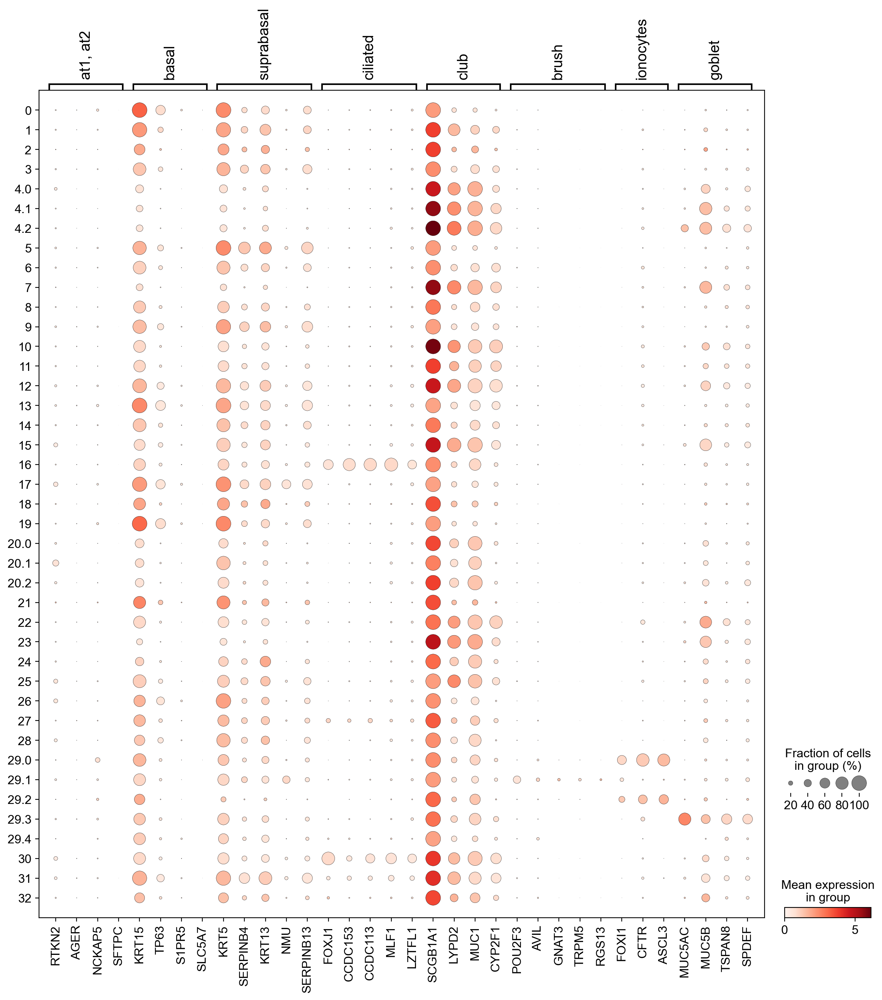

In [329]:
sc.pl.dotplot(adata, var_names=markers_fine, groupby='leiden', mean_only_expressed=True)

----------at1, at2----------


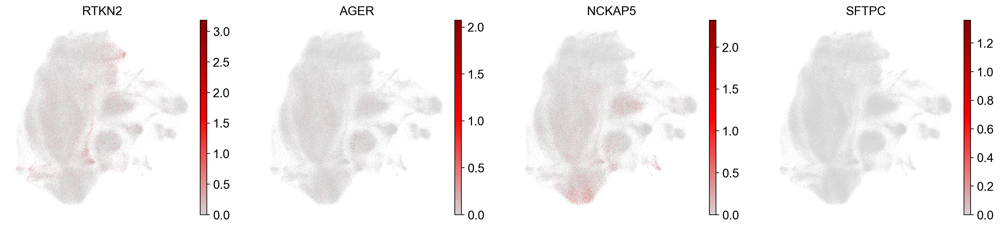

----------basal----------


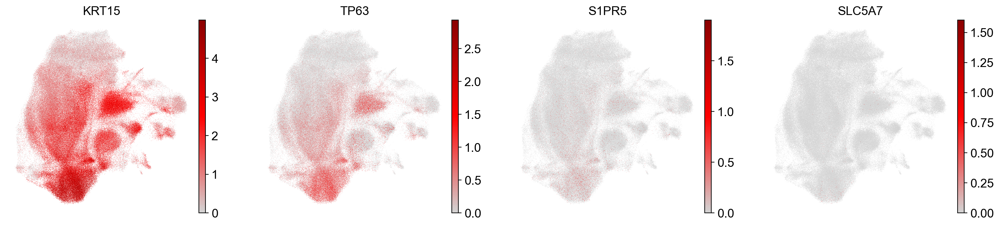

----------suprabasal----------


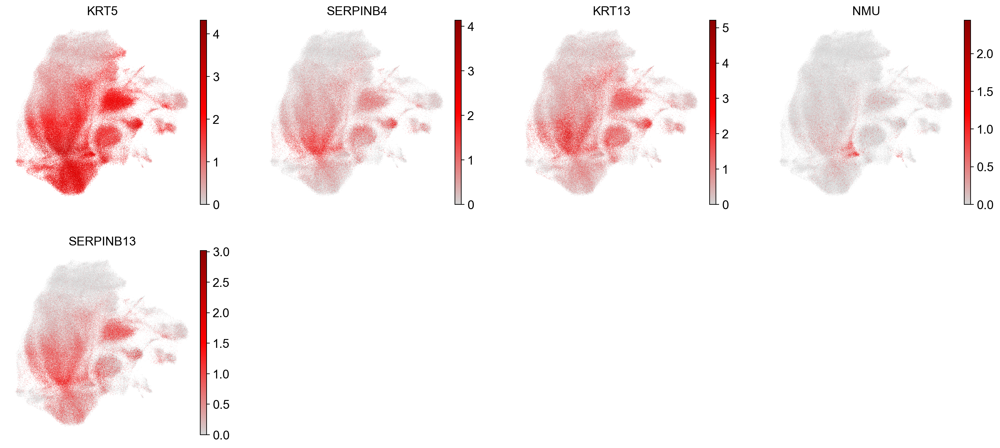

----------ciliated----------


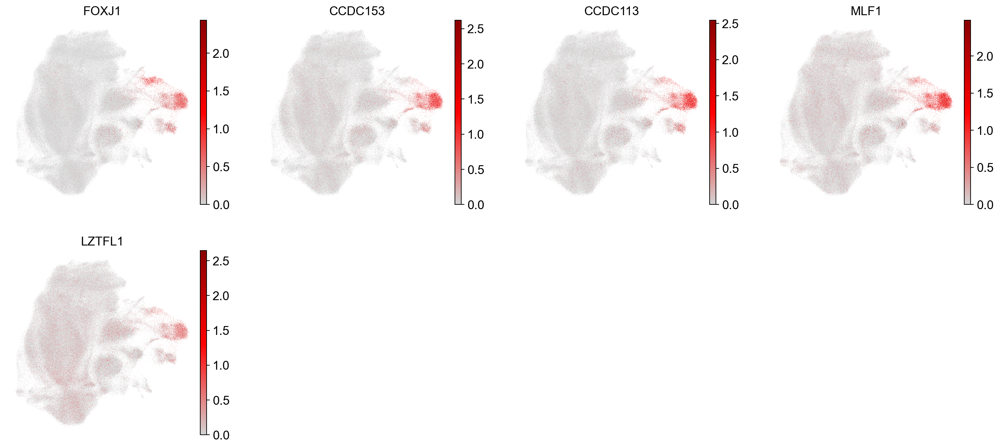

----------club----------


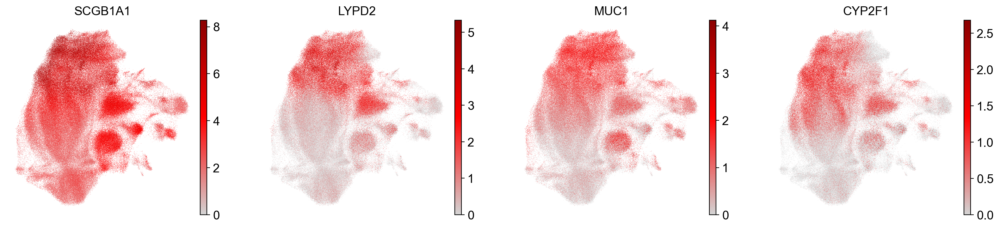

----------brush----------


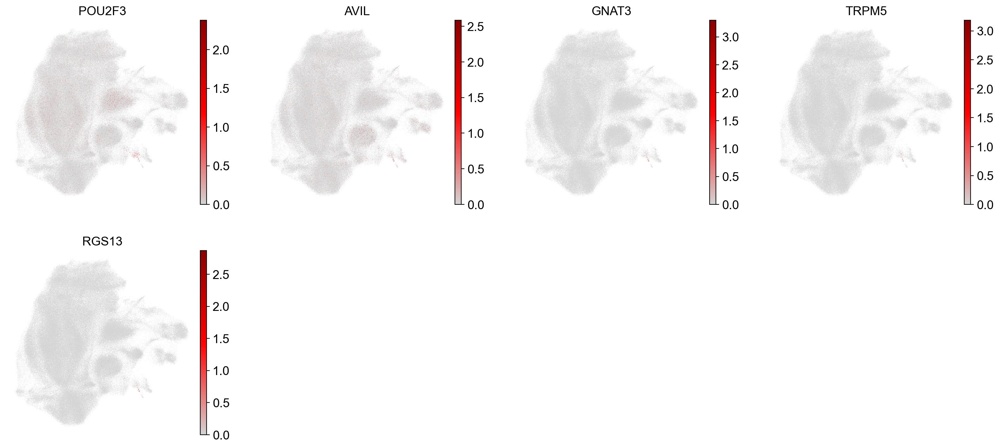

----------ionocytes----------


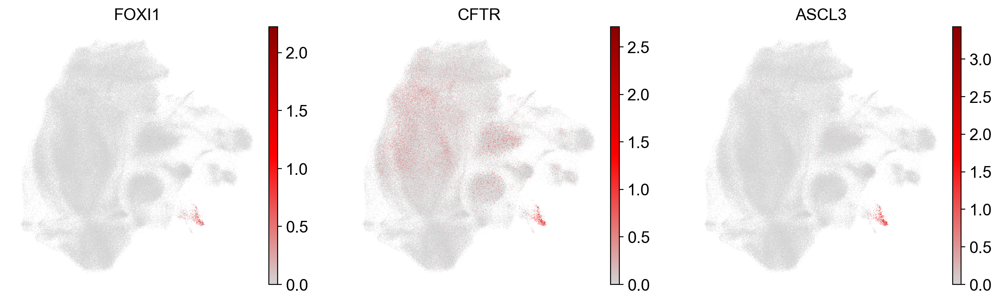

----------goblet----------


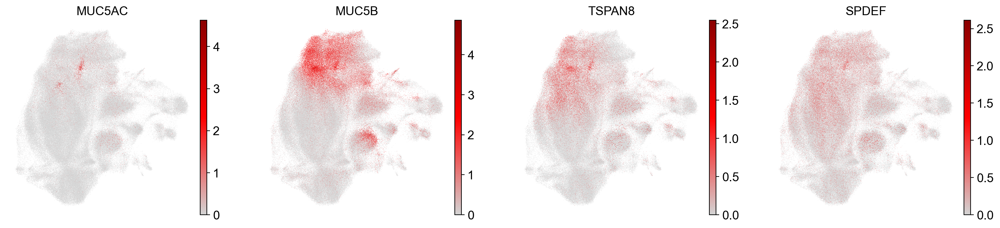

In [330]:
for k, v in markers_fine.items():
    print('-'*10 + k + '-'*10)
    sc.pl.umap(adata, color=v, color_map=gray_red)

#### annotation

Auto-annotation:

In [230]:
%%time
sc.tl.rank_genes_groups(adata, groupby='leiden', n_genes=200)
cell_annot = sc.tl.marker_gene_overlap(adata, markers_fine, normalize='reference')

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]


CPU times: user 1min 48s, sys: 41.2 s, total: 2min 29s
Wall time: 2min 30s


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical


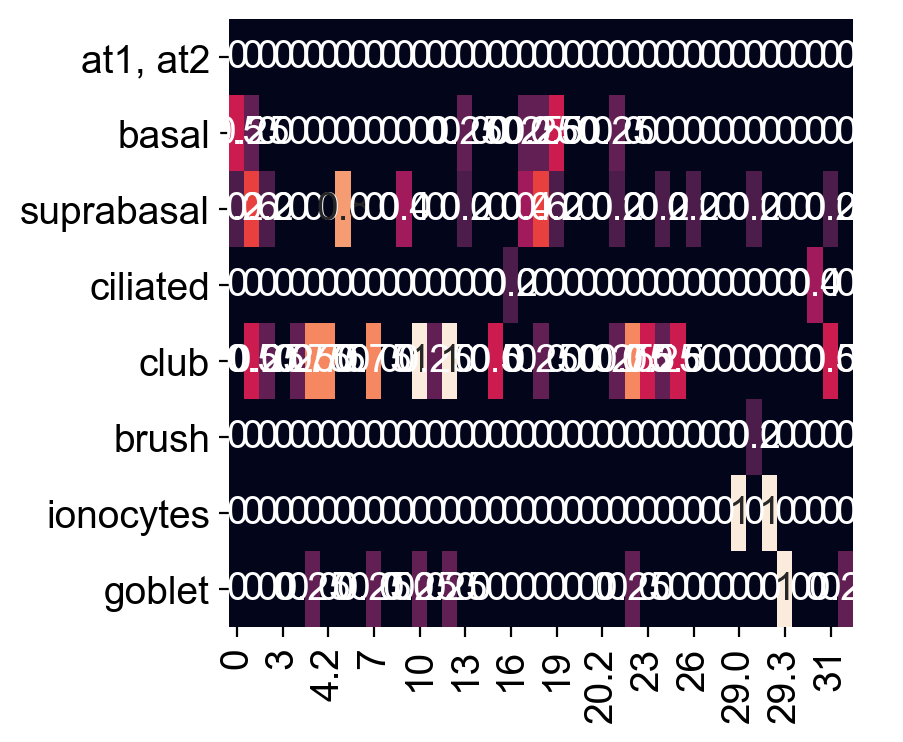

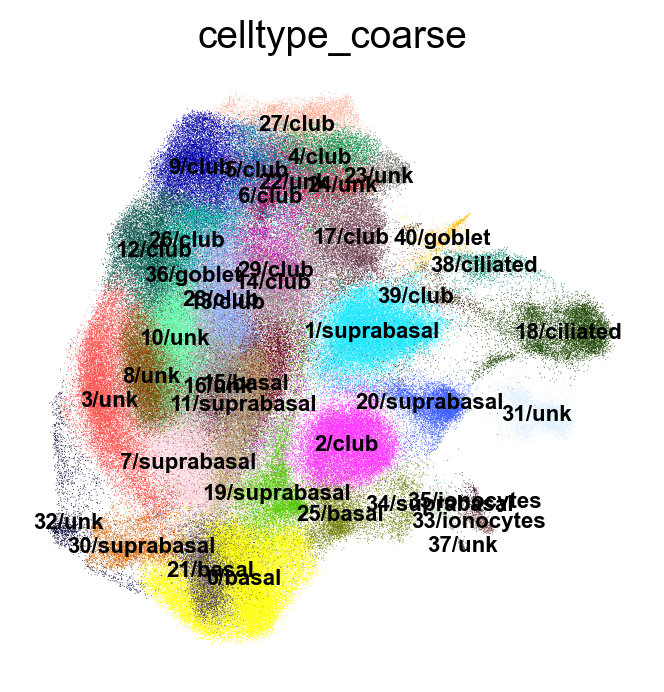

In [332]:
adata.obs['celltype_coarse'] = adata.obs['leiden']
adata.rename_categories(
    'celltype_coarse',
    [f'{i}/unk' if cell_annot.sum()[i] == 0 else f'{i}/{x}' for i, x in enumerate(cell_annot.idxmax().values)])
adata.obs['cell_type'] = [s.split('/')[1] for s in adata.obs.celltype_coarse.values]
# plots
sns.heatmap(cell_annot, cbar=False, annot=True)
sc.pl.umap(adata, color='celltype_coarse', legend_loc='on data', legend_fontsize=8)

In [348]:
cell_annot

,0,1,2,3,4.0,4.1,4.2,5,6,7,...,27,28,29.0,29.1,29.2,29.3,29.4,30,31,32
"at1, at2",0.0,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00
basal,0.5,0.25,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00
suprabasal,0.2,0.60,0.20,0.0,0.00,0.00,0.00,0.8,0.0,0.00,...,0.0,0.0,0.0,0.2,0.0,0.0,0.0,0.0,0.2,0.00
ciliated,0.0,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.4,0.0,0.00
club,0.0,0.50,0.25,0.0,0.25,0.75,0.75,0.0,0.0,0.75,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,0.00
brush,0.0,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.00,...,0.0,0.0,0.0,0.2,0.0,0.0,0.0,0.0,0.0,0.00
ionocytes,0.0,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.00,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.00
goblet,0.0,0.00,0.00,0.0,0.00,0.25,0.00,0.0,0.0,0.25,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.25


In [312]:
adata.obs['celltype_fine'] = adata.obs['celltype_coarse']

Manual re-annotation:

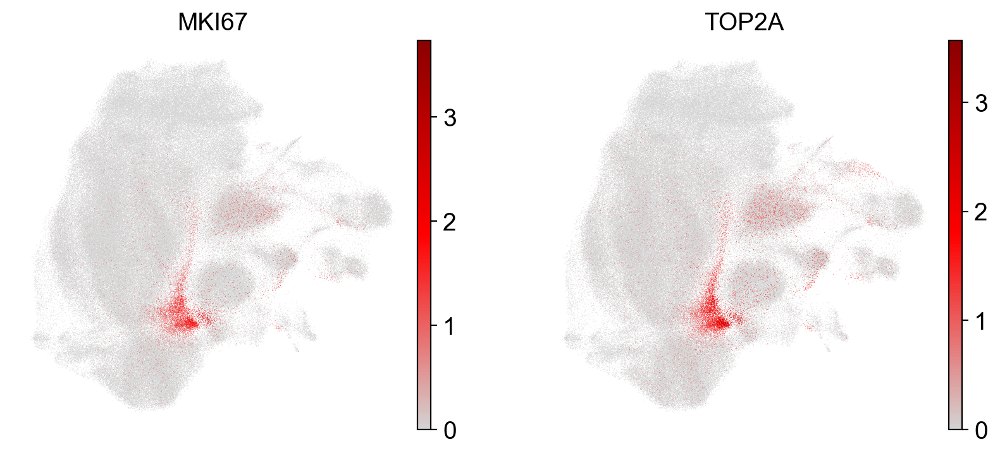

In [279]:
# proliferation markers
sc.pl.umap(adata, color=['MKI67', 'TOP2A'], color_map=gray_red)

In [333]:
adata.obs['celltype_coarse'] = adata.obs['celltype_coarse'].astype(str)
adata.obs['celltype_coarse'][adata.obs.leiden == '4.2'] = '4.2/goblet'
adata.obs['celltype_fine'] = adata.obs.celltype_fine.replace({'19/basal': '19/basal prolif.'})

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'celltype_coarse' as categorical


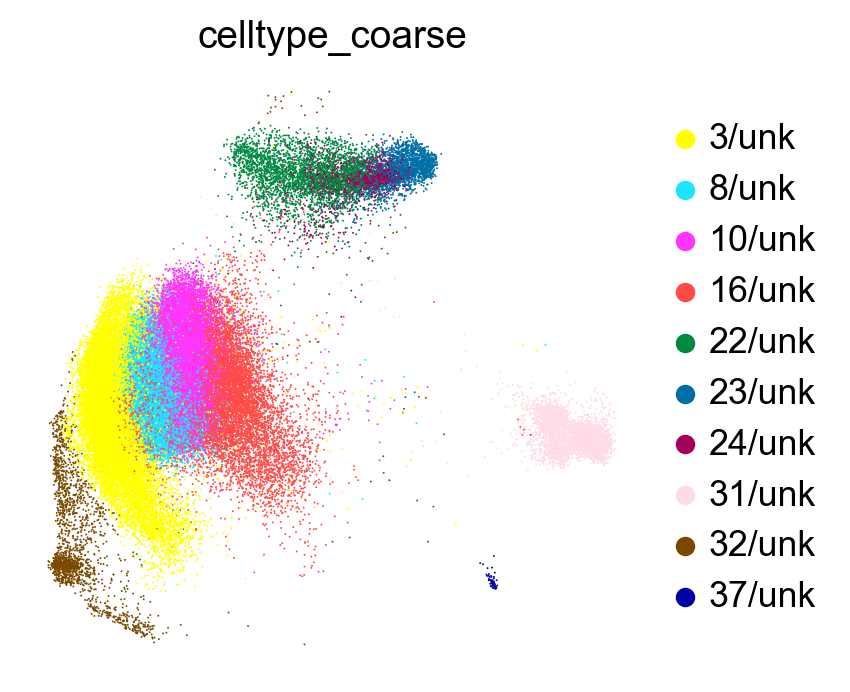

In [334]:
sc.pl.umap(adata[adata.obs.cell_type == 'unk'], color='celltype_coarse')

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.


----------at1, at2----------


... storing 'celltype_coarse' as categorical


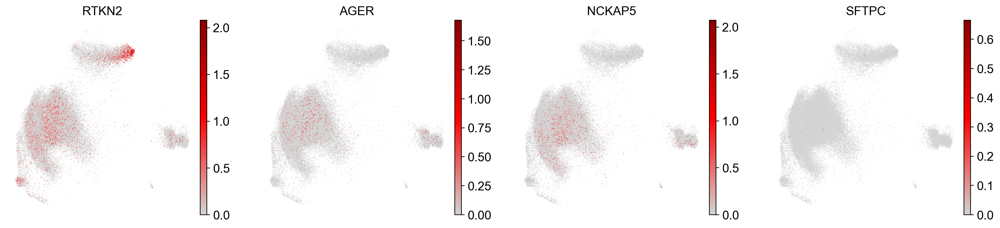

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.


----------basal----------


... storing 'celltype_coarse' as categorical


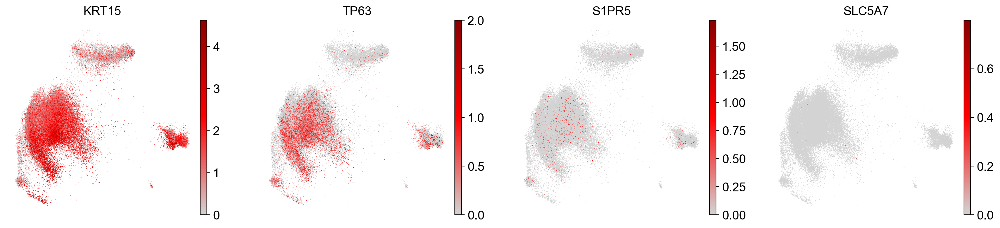

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.


----------suprabasal----------


... storing 'celltype_coarse' as categorical


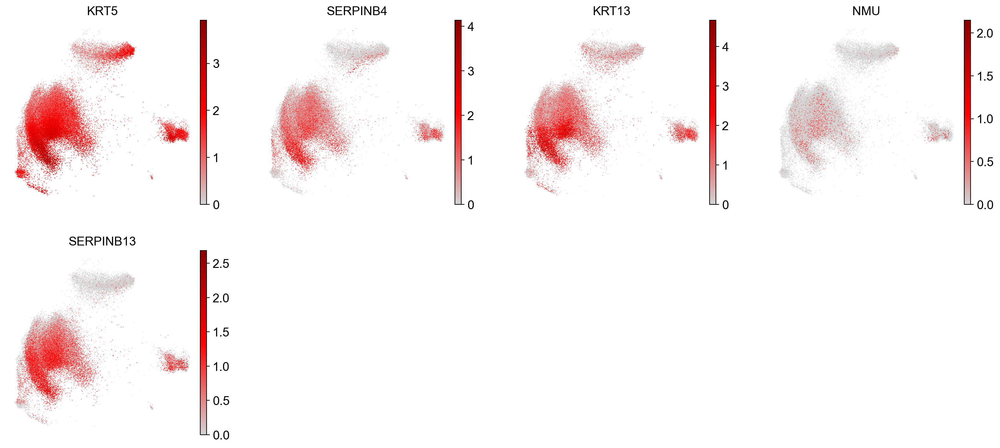

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.


----------ciliated----------


... storing 'celltype_coarse' as categorical


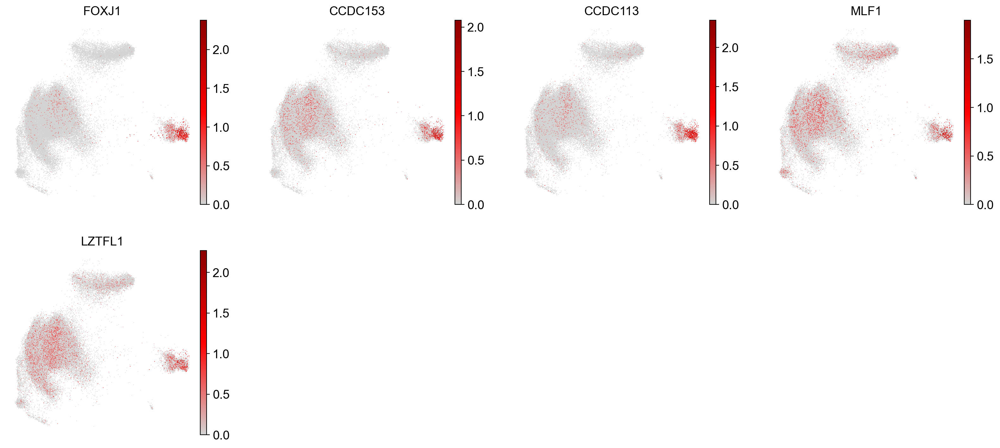

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.


----------club----------


... storing 'celltype_coarse' as categorical


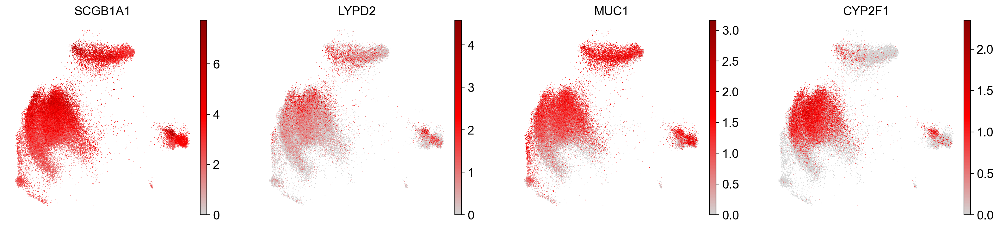

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.


----------brush----------


... storing 'celltype_coarse' as categorical


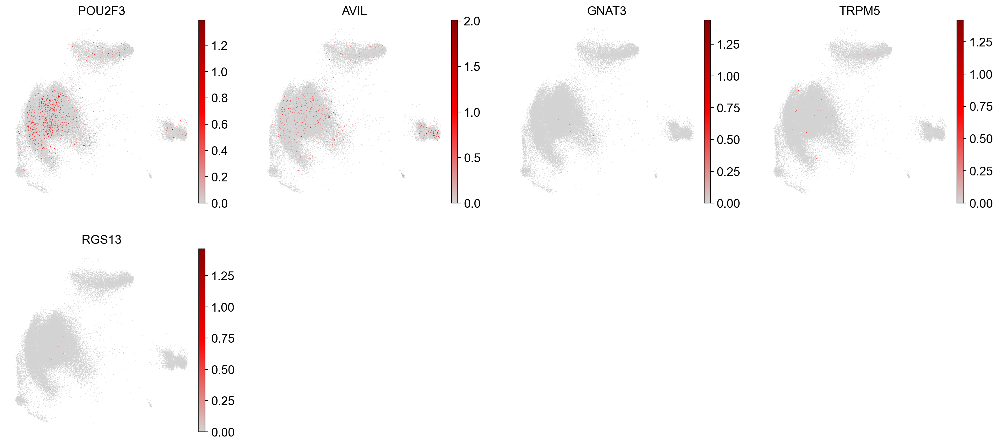

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.


----------ionocytes----------


... storing 'celltype_coarse' as categorical


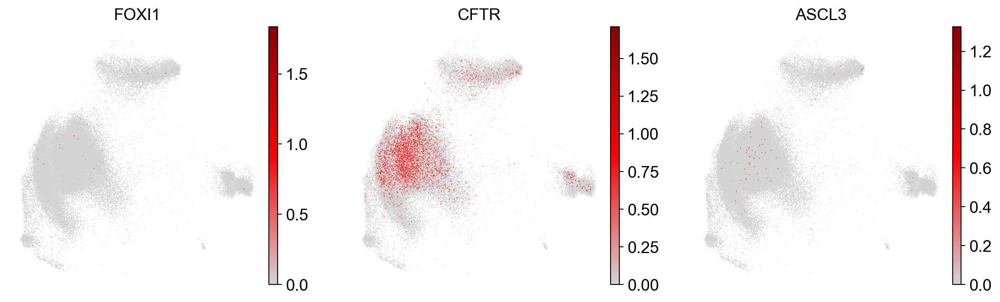

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1229: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.


----------goblet----------


... storing 'celltype_coarse' as categorical


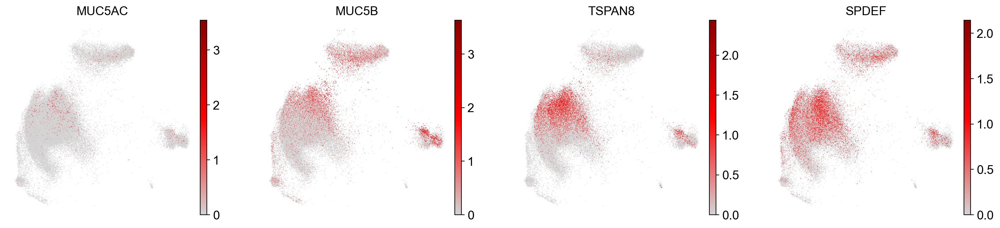

In [335]:
# resolve unknown clusters manually
for k, v in markers_fine.items():
    print('-'*10 + k + '-'*10)
    sc.pl.umap(adata[adata.obs.cell_type == 'unk'], color=v, color_map=gray_red)

Manually re-label viral population.

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype_coarse' as categorical


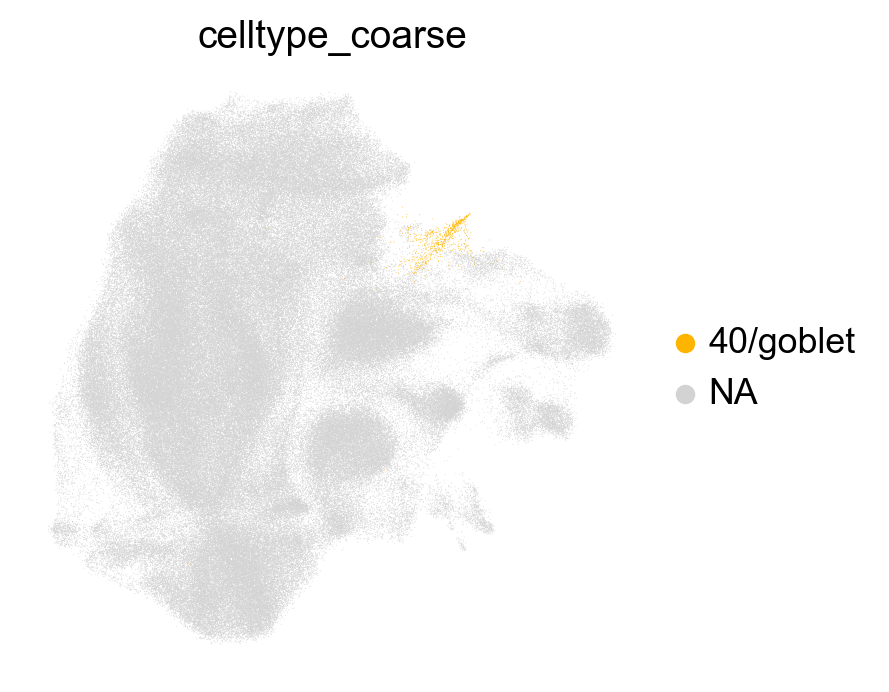

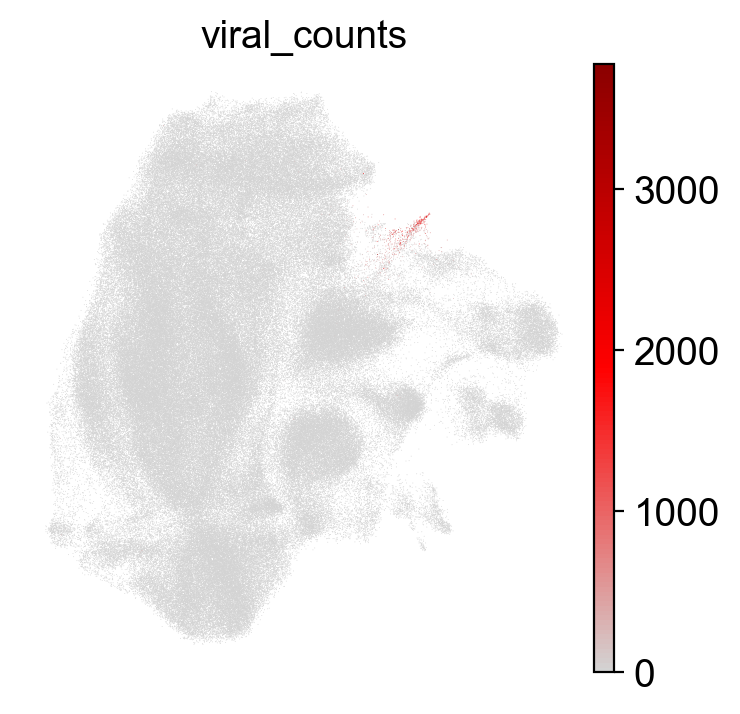

In [336]:
sc.pl.umap(adata, color='celltype_coarse', groups=['40/goblet'])
sc.pl.umap(adata, color='viral_counts', color_map=gray_red)

In [337]:
adata.obs['celltype_coarse'] = adata.obs.celltype_coarse.replace({'40/goblet': '40/viral'})

### collect when done

In [341]:
adata.obs['cell_type'] = [s.split('/')[1] for s in adata.obs.celltype_fine.values]

In [343]:
groups = ['3/unk', '8/unk', '10/unk', '16/unk']
adata.obs['cell_type'][adata.obs.celltype_coarse.isin(groups)] = 'suprabasal'
adata.obs['cell_type'][adata.obs.celltype_coarse == '32/unk'] = 'basal'
adata.obs['cell_type'][adata.obs.celltype_coarse == '22/unk'] = 'club'

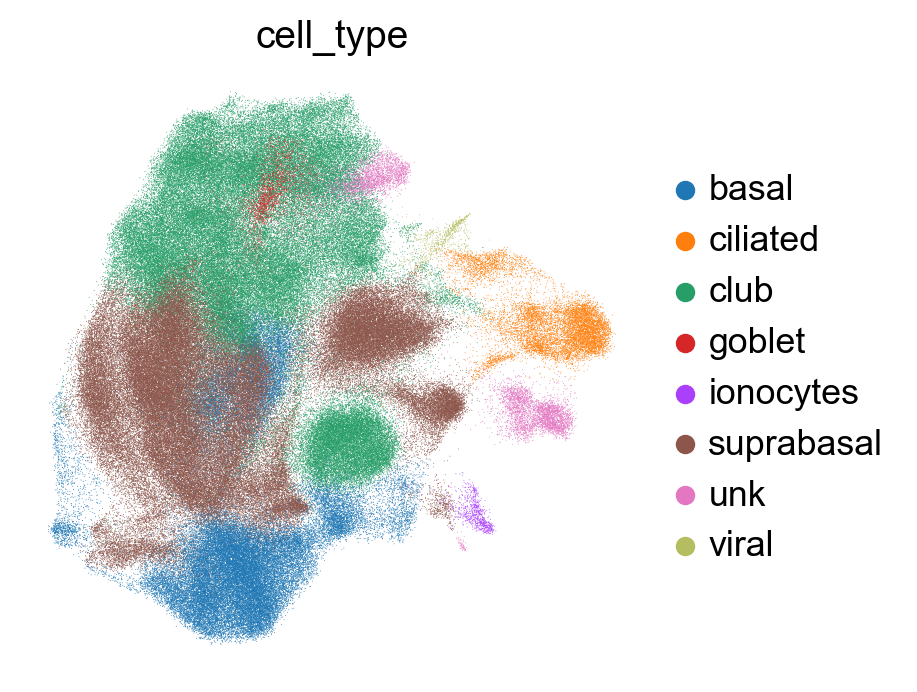

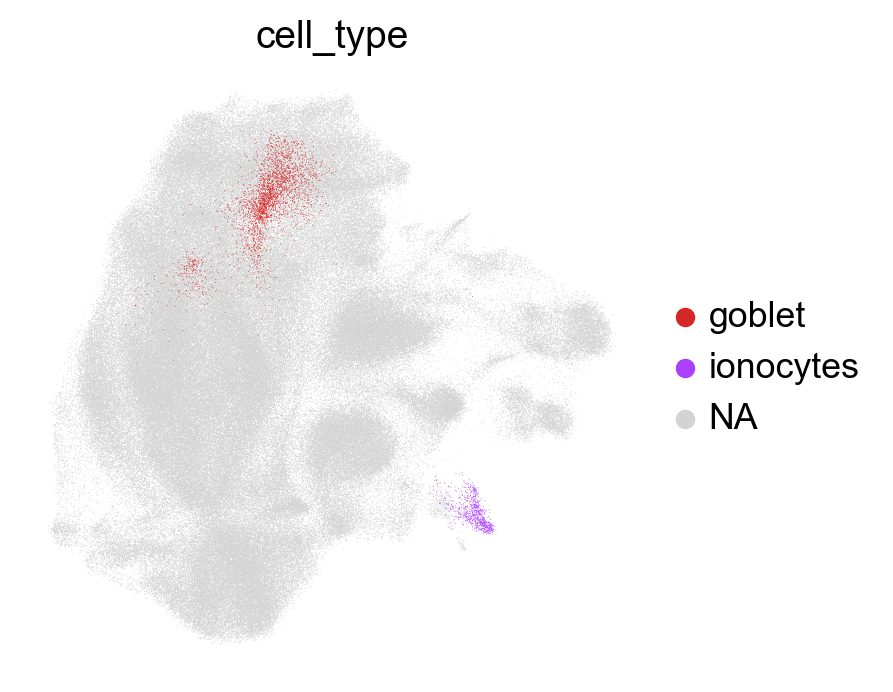

In [344]:
sc.pl.umap(adata, color='cell_type')
sc.pl.umap(adata, color='cell_type', groups=['ionocytes', 'brush', 'goblet'])

In [240]:
display(pd.crosstab(adata.obs.cell_type, adata.obs.patient))
adata.obs.cell_type.value_counts()

patient,patient_1,patient_2,patient_3,patient_4
cell_type,,,,
basal,6997,4417,100065,58747
brush,32,15,231,220
ciliated,141,136,1733,7857
club,34177,16155,20823,36796
goblet,680,2018,142,184
ionocytes,242,98,344,193
unk,572,2638,129,3784
viral,234,70,147,336


basal        170226
club         107951
ciliated       9867
unk            7123
goblet         3024
ionocytes       877
viral           787
brush           498
Name: cell_type, dtype: int64

### Examine remaining unknown clusters

In [4]:
adata = sc.read('/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/211015_annot_patient_integrated.h5ad')

Trying to set attribute `.uns` of view, copying.


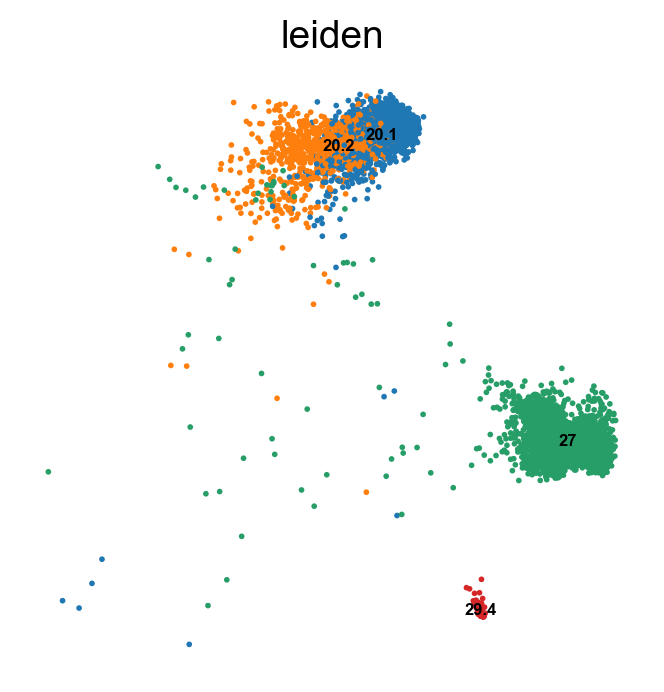

In [7]:
sc.pl.umap(adata[adata.obs.cell_type == 'unk'], color='leiden', legend_loc='on data', legend_fontsize=6)

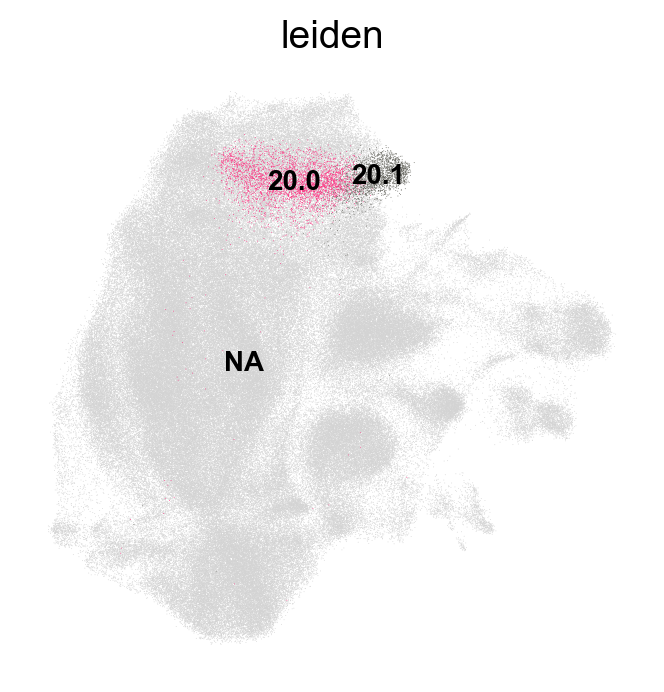

,names,scores,logfoldchanges,pvals,pvals_adj
0,TMSB4X,183.441925,2.159712,0.0,0.0
1,TMSB10,161.886429,1.941372,0.0,0.0
2,KRT7,124.130890,3.374023,0.0,0.0
3,CDKN2A,116.865936,3.098181,0.0,0.0
4,SAA1,109.216705,4.706808,0.0,0.0
5,RPS27L,107.710594,2.354522,0.0,0.0
6,B2M,106.156487,1.644036,0.0,0.0
7,KRT23,105.798256,2.974522,0.0,0.0
8,FTH1,104.776924,1.851871,0.0,0.0
9,S100A10,103.202080,2.452727,0.0,0.0


In [8]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', legend_fontsize=10, groups=['20.0', '20.1'])

df = sc.get.rank_genes_groups_df(adata, group='20.1')
df = df[df.names.isin(sc.get.rank_genes_groups_df(adata, group='20.2').names.values)]
df.to_csv('leiden_cluster_20_top_genes.csv')
df.head(20)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical


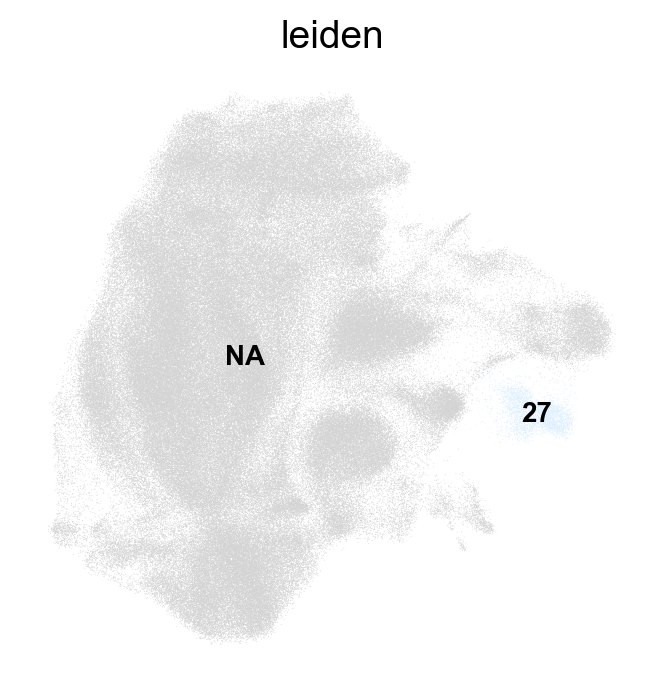

,names,scores,logfoldchanges,pvals,pvals_adj
0,MT-ND2,111.319977,2.132427,0.0,0.0
1,DNAAF1,107.801086,6.533962,0.0,0.0
2,MT-ND3,105.327911,2.032915,0.0,0.0
3,DNAH5,98.022293,5.888188,0.0,0.0
4,MT-ATP6,92.826172,1.688410,0.0,0.0
5,MT-ND5,90.148193,1.849090,0.0,0.0
6,MT-CO2,89.636864,1.455124,0.0,0.0
7,MT-CYB,88.331680,1.498964,0.0,0.0
8,DNAH12,87.013344,6.414374,0.0,0.0
9,MUC16,86.969757,2.418180,0.0,0.0


In [13]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', legend_fontsize=10, groups='27')

df = sc.get.rank_genes_groups_df(adata, group='27')
df.to_csv('leiden_cluster_27_top_genes.csv')
df.head(20)

This cluster also contained the ciliated markers but was separate - possibly due to high mitochondrial content? Although, only 63 of the top 200 genes were overlapping, so maybe there are other differences as well.

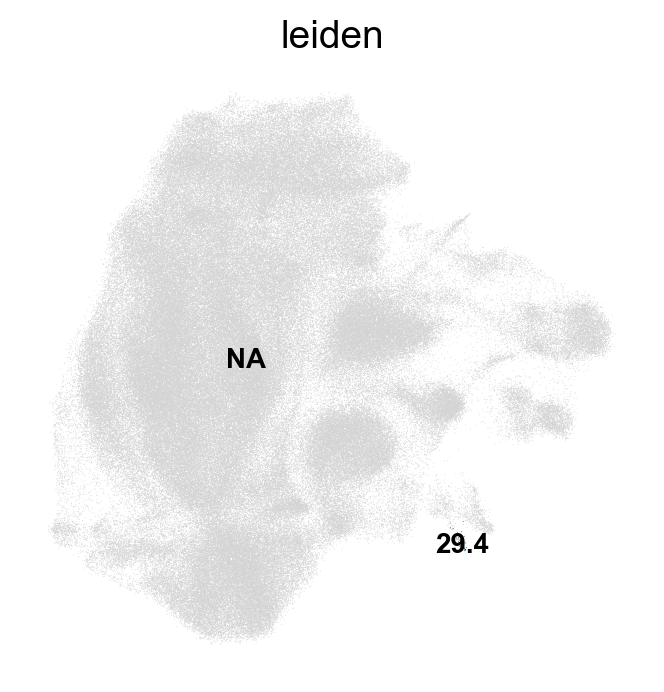

,names,scores,logfoldchanges,pvals,pvals_adj
0,SEC11C,53.517891,6.551846,1.953506e-50,1.366323e-49
1,IGFBP5,27.863270,7.605816,6.832783e-35,4.311245e-34
2,AZGP1,27.136009,8.221581,2.783556e-34,1.747803e-33
3,TFF3,26.591314,7.230313,8.113221e-34,5.057502e-33
4,CALCA,24.172121,14.012794,1.210429e-31,7.420275e-31
5,KRT18,21.876211,2.252271,2.008796e-29,1.210557e-28
6,CD24,20.349573,1.902620,7.695942e-28,4.569387e-27
7,CALM1,20.160255,1.918240,1.251905e-27,7.416043e-27
8,ASCL1,19.522408,13.961510,6.429414e-27,3.783913e-26
9,KRT8,18.754595,1.915997,4.553500e-26,2.655719e-25


In [311]:
sc.pl.umap(adata, color=['leiden'], legend_loc='on data', legend_fontsize=10, groups='29.4')

df = sc.get.rank_genes_groups_df(adata, group='29.4')
df.to_csv('leiden_cluster_29_top_genes.csv')
df.head(20)

In [20]:
adata.obs['cell_type'] = adata.obs['cell_type'].astype(str)  # to allow additional labels
adata.obs['cell_type'][adata.obs.leiden.isin(['20.0', '20.1'])] = 'unk TMSB+ cells'
adata.obs['cell_type'][adata.obs.leiden == '27'] = 'unk MT high cells'

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [10]:
# set color palette on infection and clean up for figure plot
adata.uns['infected_colors'] = ['grey', 'darkred']
adata = adata[adata.obs.treatment != 'nan']

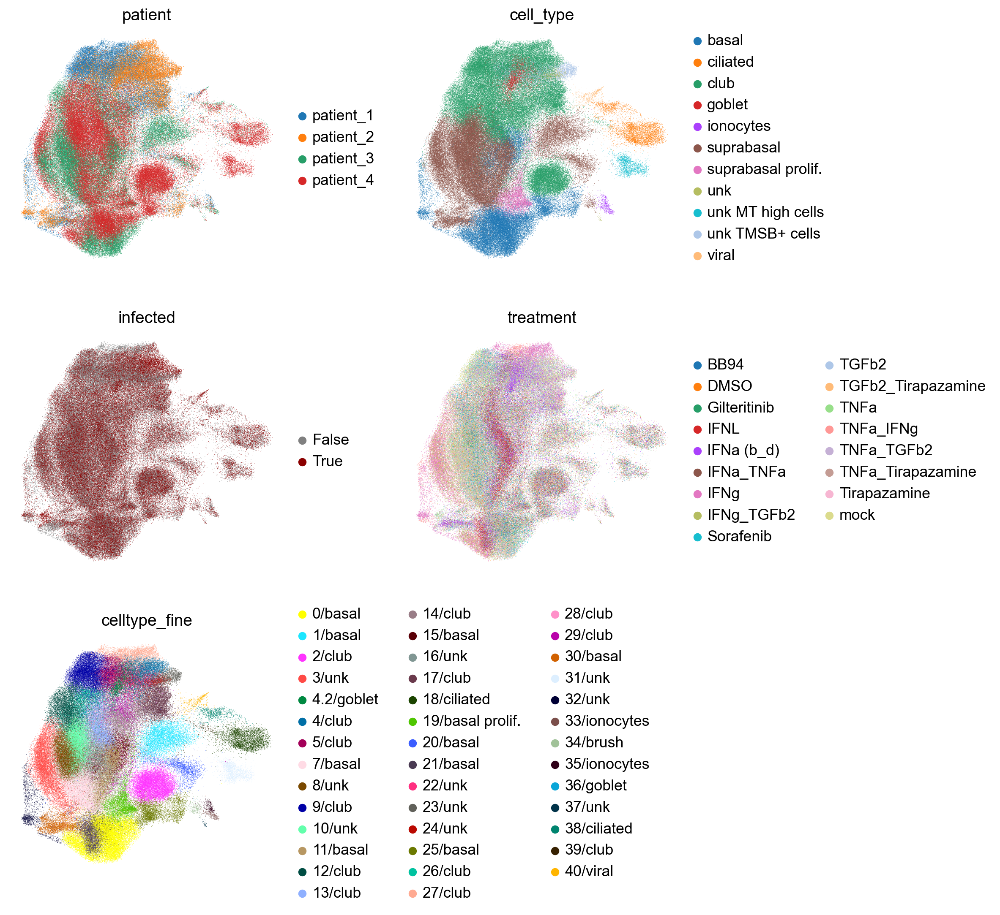

In [28]:
sc.pl.umap(adata, color=['patient', 'cell_type', 'infected', 'treatment', 'celltype_fine'], wspace=.3, ncols=2)

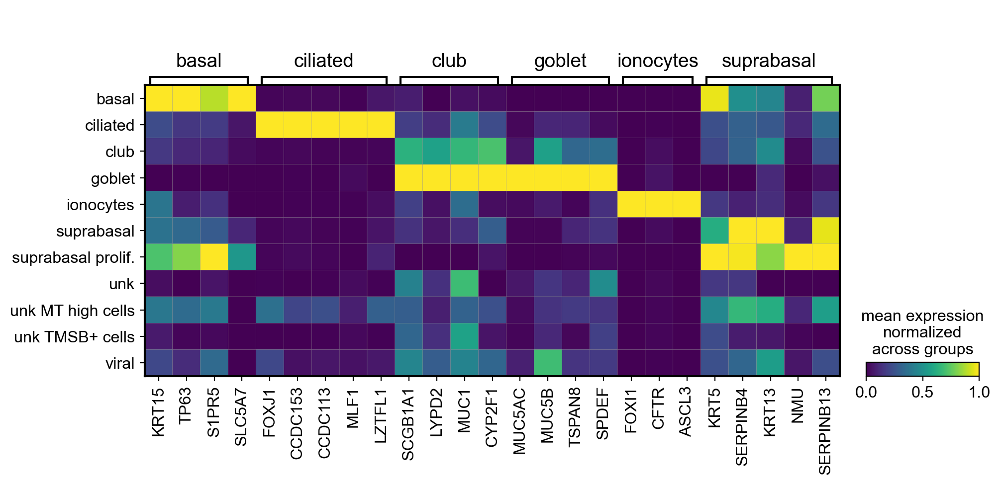

In [24]:
markers_fine = {
#     'at1, at2': ['RTKN2', 'AGER', 'NCKAP5', 'SFTPC'],
    'basal': ['KRT15', 'TP63', 'S1PR5', 'SLC5A7'],
    'ciliated': ['FOXJ1', 'CCDC153', 'CCDC113', 'MLF1', 'LZTFL1'],
    'club': ['SCGB1A1', 'LYPD2', 'MUC1', 'CYP2F1'],
    'goblet': ['MUC5AC', 'MUC5B', 'TSPAN8', 'SPDEF'],
    'ionocytes': ['FOXI1', 'CFTR', 'ASCL3'],
    'suprabasal': ['KRT5', 'SERPINB4', 'KRT13', 'NMU', 'SERPINB13'],
#     'viral':[]
#     'brush': ['POU2F3', 'AVIL', 'GNAT3', 'TRPM5', 'RGS13'],
}
sc.pl.matrixplot(adata, var_names=markers_fine, groupby='cell_type', standard_scale='var', var_group_rotation=0, colorbar_title='mean expression\nnormalized\nacross groups')

#### Write

In [22]:
adata.write('/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/211015_annot_patient_integrated.h5ad')